In [76]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.datasets import make_classification
from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
from IPython.display import HTML
from sklearn.preprocessing import LabelEncoder, PolynomialFeatures
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score
from mlxtend.plotting import plot_decision_regions
%matplotlib inline

In [2]:
x, y = make_classification(n_samples=100, n_features=2, n_informative=1, n_redundant=0,
                          n_classes=2, n_clusters_per_class=1, random_state=41, hypercube=False, 
                          class_sep=10)

In [3]:
df1 = pd.DataFrame(data = {'x1':x[:,0], 'x2':x[:,1], 'y':y})
df1.head()

,x1,x2,y
0,0.199247,-0.116976,1
1,-0.248820,-0.731152,1
2,-0.354490,-0.708106,1
3,-1.590865,-2.011992,0
4,-0.200840,1.634932,1


In [4]:
df1.describe()

,x1,x2,y
count,100.000000,100.000000,100.000000
mean,-0.530472,0.060770,0.500000
std,1.158693,0.938258,0.502519
min,-2.400676,-2.980924,0.000000
25%,-1.496951,-0.544073,0.000000
50%,-0.734673,0.172038,0.500000
75%,0.564662,0.710422,1.000000
max,2.144882,2.061587,1.000000


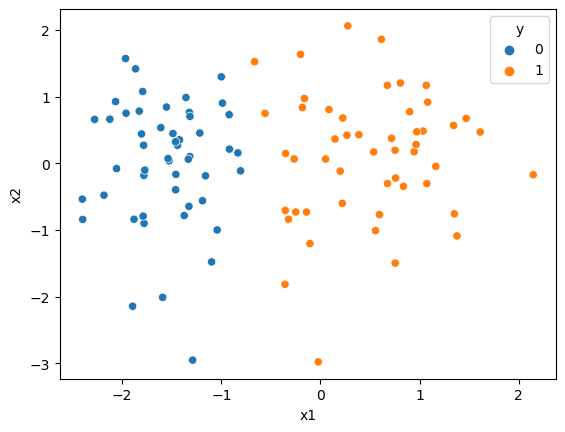

In [5]:
sns.scatterplot(data=df1, x='x1', y='x2', hue = 'y')
plt.show()

In [6]:
def perceptron(x, y, lr=0.1):
    """ 
    to calculate intercept and slopes
    """
    x1 = np.insert(x, 0, 1, axis = 1)
    weights = np.ones(x1.shape[1])
    for i in range(1000):
        j = np.random.randint(0, 100)
        y_hat = 1 if np.dot(x1[j], weights)>0 else 0
        weights = weights + lr*(y[j] - y_hat)*x1[j]
    return weights[0], weights[1:]

In [7]:
temp = df1[['x1', 'x2']]
temp = np.insert(temp, 0, 1, axis = 1)

In [8]:
temp[41]

array([ 1.        , -0.91783293,  0.21243302])

In [9]:
c, (a, b) = perceptron(x = df1[['x1', 'x2']],y = df1['y'])

In [10]:
a, b, c

(1.3663482168766192, 0.09241878776880419, 0.9)

In [11]:
# m = -A/B, c = C/B
slop = -a/b; intercep = -c/b

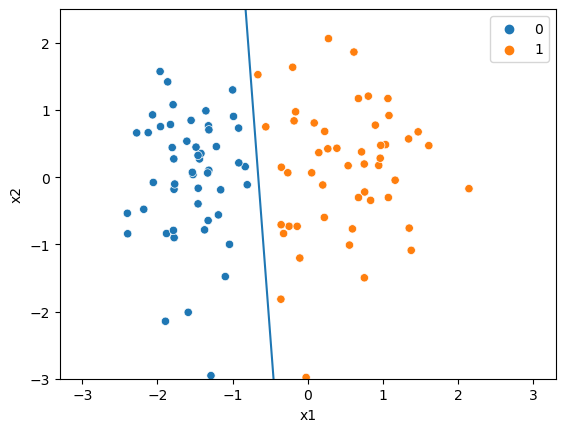

In [12]:
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df1, x='x1', y='x2', hue = 'y')
sns.lineplot(x=xi, y=slop*xi+intercep)
plt.ylim(-3,2.5)
plt.show()

In [13]:
# animation
all_m = []
all_c = []
def perceptron2(x, y, lr=0.1):
    """ 
    to calculate intercept and slopes
    """
    x1 = np.insert(x, 0, 1, axis = 1)
    weights = np.ones(x1.shape[1])
    for i in range(1000):
        j = np.random.randint(0, 100)
        y_hat = 1 if np.dot(x1[j], weights)>0 else 0
        weights = weights + lr*(y[j] - y_hat)*x1[j]
        c, (a, b) = weights[0], weights[1:]
        all_m.append(-a/b)
        all_c.append(-c/b)
perceptron2(x = df1[['x1', 'x2']],y = df1['y'])

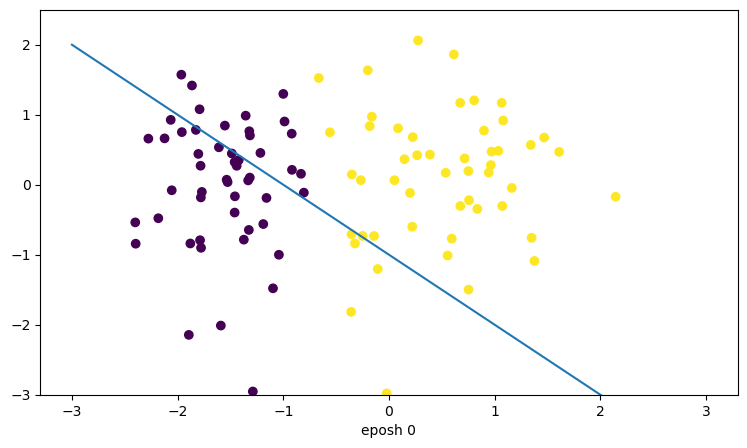

In [14]:
fig, ax = plt.subplots(figsize=(9,5))
xi = np.linspace(-3,3,2)
yi = 1*xi + 1
ax.set_ylim(-3,2.5)
ax.scatter(x=df1['x1'], y=df1['x2'], c = df1['y'])
line, = ax.plot(xi, yi)

def ani_frame(i):
    label = f'eposh {i}'
    line.set_ydata(all_m[i]*xi + all_c[i])
    ax.set_xlabel(label)
# plt.legend()
animation3 = FuncAnimation(fig, ani_frame, 100, interval = 200)

In [15]:
from IPython.display import HTML
HTML(animation3.to_jshtml())

In [16]:
HTML(animation3.to_html5_video())

In [17]:
lor = LogisticRegression()
lor.fit(x,y)

LogisticRegression()

In [18]:
m_lor = -(lor.coef_[0][0]/lor.coef_[0][1])
c_lor = -(lor.intercept_[0]/lor.coef_[0][1])
display(m_lor, c_lor)

-127.34979670277532

-81.91311980919602

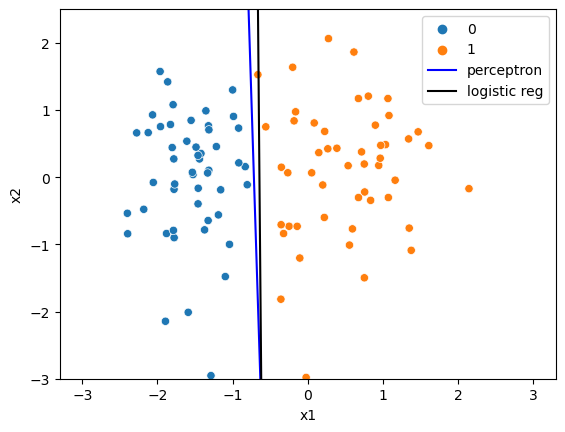

In [19]:
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df1, x='x1', y='x2', hue = 'y')
sns.lineplot(x=xi, y=all_m[-1]*xi+all_c[-1], color = 'blue', label='perceptron')
sns.lineplot(x=xi, y=m_lor*xi+c_lor, color = 'black', label = 'logistic reg')
plt.ylim(-3,2.5)
plt.show()

here we can not say which one is better, but we can do one thing, changing the data separation distance, and then comparing both perceptron and logistic regression trick.

In [20]:
x_1, y_1 = make_classification(n_samples=100, n_features=2, n_informative=1, n_redundant=0,
                          n_classes=2, n_clusters_per_class=1, random_state=41, hypercube=False, 
                          class_sep=20)

In [21]:
df2 = pd.DataFrame(data = {'x1':x_1[:,0], 'x2':x_1[:,1], 'y':y_1})
df2.head()

,x1,x2,y
0,0.511231,-0.116976,1
1,0.063164,-0.731152,1
2,-0.042506,-0.708106,1
3,-3.289157,-2.011992,0
4,0.111144,1.634932,1


In [22]:
df2.describe()

,x1,x2,y
count,100.000000,100.000000,100.000000
mean,-1.223626,0.060770,0.500000
std,2.107706,0.938258,0.502519
min,-4.098968,-2.980924,0.000000
25%,-3.195243,-0.544073,0.000000
50%,-1.427827,0.172038,0.500000
75%,0.876646,0.710422,1.000000
max,2.456866,2.061587,1.000000


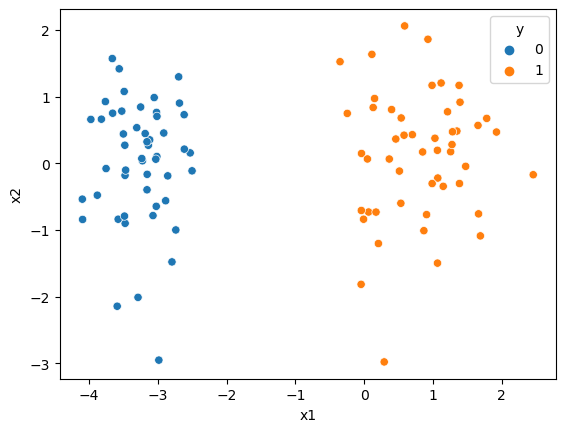

In [23]:
sns.scatterplot(data=df2, x='x1', y='x2', hue = 'y')
plt.show()

In [24]:
temp = df2[['x1', 'x2']]
temp = np.insert(temp, 0, 1, axis = 1)

In [25]:
temp[41]

array([ 1.        , -2.61612476,  0.21243302])

In [26]:
c, (a, b) = perceptron(x = df2[['x1', 'x2']],y = df2['y'])

In [27]:
a, b, c

(1.0198595950437912, 0.33857968939243677, 1.3000000000000003)

In [28]:
# m = -A/B, c = C/B
slop = -a/b; intercep = -c/b

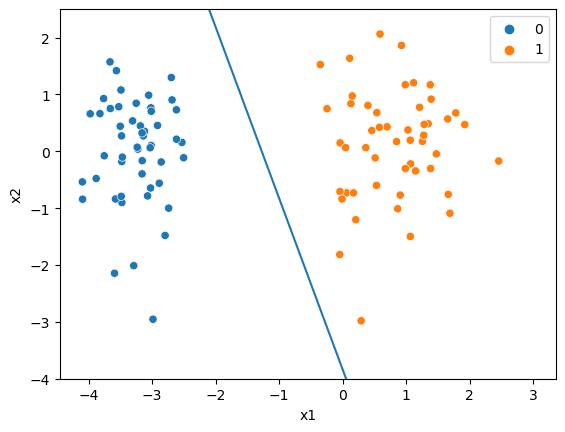

In [29]:
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df2, x='x1', y='x2', hue = 'y')
sns.lineplot(x=xi, y=slop*xi+intercep)
plt.ylim(-4,2.5)
plt.show()

In [30]:
# animation
all_m = []
all_c = []
def perceptron2(x, y, lr=0.1):
    """ 
    to calculate intercept and slopes
    """
    x1 = np.insert(x, 0, 1, axis = 1)
    weights = np.ones(x1.shape[1])
    for i in range(1000):
        j = np.random.randint(0, 100)
        y_hat = 1 if np.dot(x1[j], weights)>0 else 0
        weights = weights + lr*(y[j] - y_hat)*x1[j]
        c, (a, b) = weights[0], weights[1:]
        all_m.append(-a/b)
        all_c.append(-c/b)
perceptron2(x = df2[['x1', 'x2']],y = df2['y'])

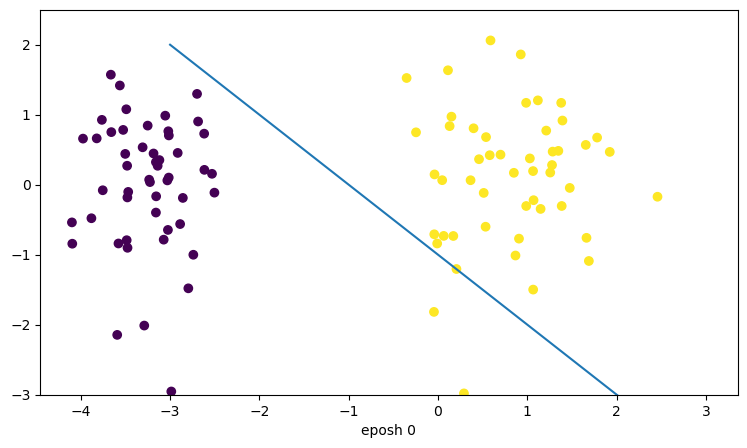

In [31]:
fig, ax = plt.subplots(figsize=(9,5))
xi = np.linspace(-3,3,2)
yi = 1*xi + 1
ax.set_ylim(-3,2.5)
ax.scatter(x=df2['x1'], y=df2['x2'], c = df2['y'])
line, = ax.plot(xi, yi)

def ani_frame(i):
    label = f'eposh {i}'
    line.set_ydata(all_m[i]*xi + all_c[i])
    ax.set_xlabel(label)
# plt.legend()
animation3 = FuncAnimation(fig, ani_frame, 300, interval = 50)

In [32]:
from IPython.display import HTML
HTML(animation3.to_jshtml())

In [33]:
HTML(animation3.to_html5_video())

In [157]:
from sklearn.linear_model import LogisticRegression
lor2 = LogisticRegression()
lor2.fit(x_1,y_1)

LogisticRegression()

In [158]:
m_lor2 = -(lor2.coef_[0][0]/lor2.coef_[0][1])
c_lor2 = -(lor2.intercept_[0]/lor2.coef_[0][1])
display(m_lor2, c_lor2)

-108.63393776921423

-143.9574588035248

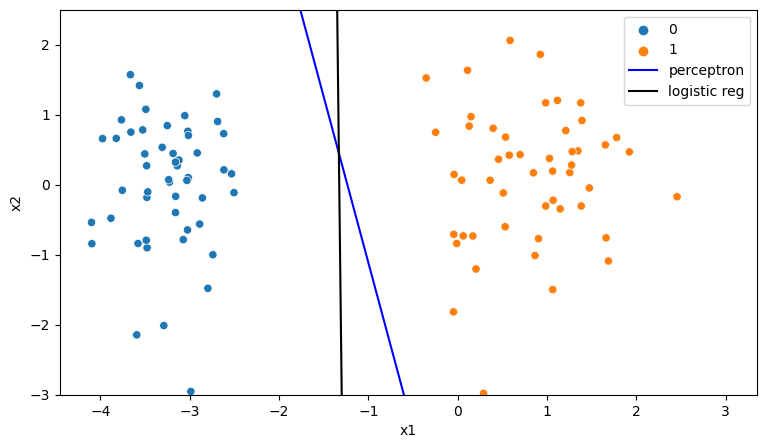

In [159]:
plt.figure(figsize = (9,5))
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df2, x='x1', y='x2', hue = 'y')
sns.lineplot(x=xi, y=all_m[-1]*xi+all_c[-1], color = 'blue', label='perceptron')
sns.lineplot(x=xi, y=m_lor2*xi+c_lor2, color = 'black', label = 'logistic reg')
plt.ylim(-3,2.5)
plt.show()

The reason why logistic reg is more better than perceptron is, perceptron stop working as soon as all the points get classify correctly. But logictic regression improved itself even after that, and it more symmeterically classifying the classes.

So, the problem with perceptron trick is, it doesn't give best line, even it classifying all point of training data correctly but it will give major error on test data.

### Using sigmoid function 

In [37]:
def perceptron3(x, y, lr=0.1):
    def sigmoid(x):
        import math
        return 1/(1+math.exp(-x))
    """ 
    to calculate intercept and slopes with sigmoid
    """
    x1 = np.insert(x, 0, 1, axis = 1)
    weights = np.ones(x1.shape[1])
    for i in range(1000):
        j = np.random.randint(0, 100)
        y_hat = sigmoid(np.dot(x1[j], weights))
        weights = weights + lr*(y[j] - y_hat)*x1[j]
    return weights[0], weights[1:]

In [38]:
c, (a, b) = perceptron3(x = df2[['x1', 'x2']],y = df2['y'])

In [39]:
a, b, c

(2.81597464264007, 0.1265822903510279, 2.8893351194490347)

In [40]:
lor2.coef_

array([[2.36687798, 0.02178765]])

In [41]:
# m = -A/B, c = C/B
slop = -a/b; intercep = -c/b

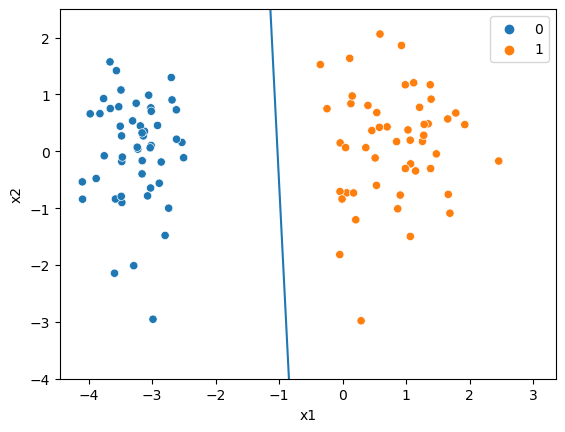

In [42]:
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df2, x='x1', y='x2', hue = 'y')
sns.lineplot(x=xi, y=slop*xi+intercep)
plt.ylim(-4,2.5)
plt.show()

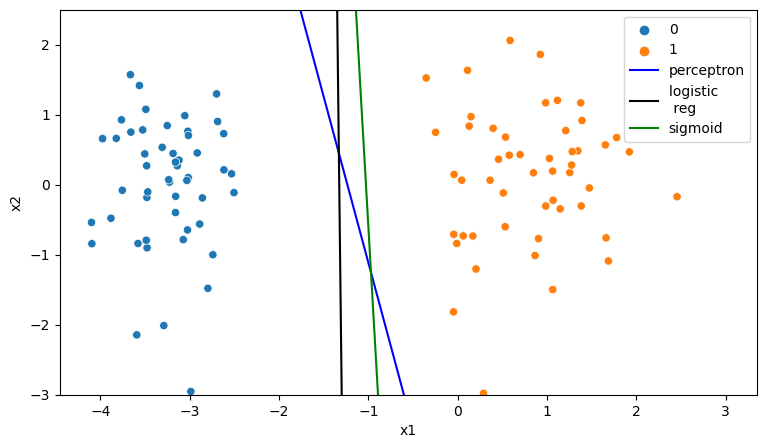

In [160]:
plt.figure(figsize = (9,5))
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df2, x='x1', y='x2', hue = 'y')
sns.lineplot(x=xi, y=all_m[-1]*xi+all_c[-1], color = 'blue', label='perceptron')
sns.lineplot(x=xi, y=m_lor2*xi+c_lor2, color = 'black', label = 'logistic \n reg')
sns.lineplot(x=xi, y=slop*xi+intercep, color = 'green', label = 'sigmoid')
plt.ylim(-3,2.5)
plt.show()

Even sigmoid by us is not up to the scikit learn logistic regression line. That means sklearn using more optimized and better algo. 
The reason is, we used eposh to find the weights. there is no criteria of best line in our algo. We are randomly selecting the points and asking them to push the line if correctly classified and and pull the line if misclassified in a loop and assuming to get the best line which is not possible. Everytime in loop, different points will be selected and we will have different solution each time.

This method is not used in ML. Instead we have to use Loss function method like in Linear regression and then solve the problem. This is the ML approach.

Loss Function will tell us which model is better and which is worst. Also do tells us how much good or bad our model is.

### Using Loss Function and Gradient descent
$$ W_{new} = W_{old} + \eta * \frac {1}{n}*[Y - \hat Y]*X$$ &ensp;where $n$ = no. of rows, $\eta$ = learning rate, $X$ = matrix of independent features, $Y$ = matrix of dependent feature, $W$= weights.

In [44]:
df2

,x1,x2,y
0,0.511231,-0.116976,1
1,0.063164,-0.731152,1
2,-0.042506,-0.708106,1
3,-3.289157,-2.011992,0
4,0.111144,1.634932,1
...,...,...,...
95,-3.821619,0.661988,0
96,-3.234290,0.071533,0
97,-3.158639,0.323236,0
98,1.148250,-0.345742,1


In [155]:
lor3 = LogisticRegression(penalty=None,solver='sag')
# penalty = None means no regularisation will be used. Logistic regression use regularisation by default.
## we removed regularisation here as we are not going to use any regularisation in our function too
# there are many solvers, we choose simple one here sag
lor3.fit(x_1,y_1)
m_lor3 = -(lor2.coef_[0][0]/lor2.coef_[0][1])
c_lor3 = -(lor2.intercept_[0]/lor2.coef_[0][1])
display(m_lor3, c_lor3)

C:\ProgramData\miniforge3\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


-21.704946394384088

-26.045385853522998

In [121]:
def Logistic_with_GD(x, y, epoch = 1000, lr = 0.1):
    import numpy as np
    def sigmoid(x):
        return 1/(1+np.exp(-x))    
    x = np.insert(x, 0, 1, axis = 1)
    weights = np.ones(x.shape[1])
    for i in range(epoch):
        y_hat = sigmoid(np.dot(x, weights))
        weights = weights + (lr * np.dot((y - y_hat), x) / x.shape[0])
    return weights[1:], weights[0]

In [143]:
(a, b), c = Logistic_with_GD(x = df2[['x1', 'x2']],y = df2['y'], epoch=10000, lr=0.5)

In [144]:
a, b, c

(5.330865947828991, 0.25634170723359906, 6.5330031774375)

In [145]:
m3 = -a/b
c3 = -c/b
display(m3,c3)

-20.79593681948556

-25.48552573804974

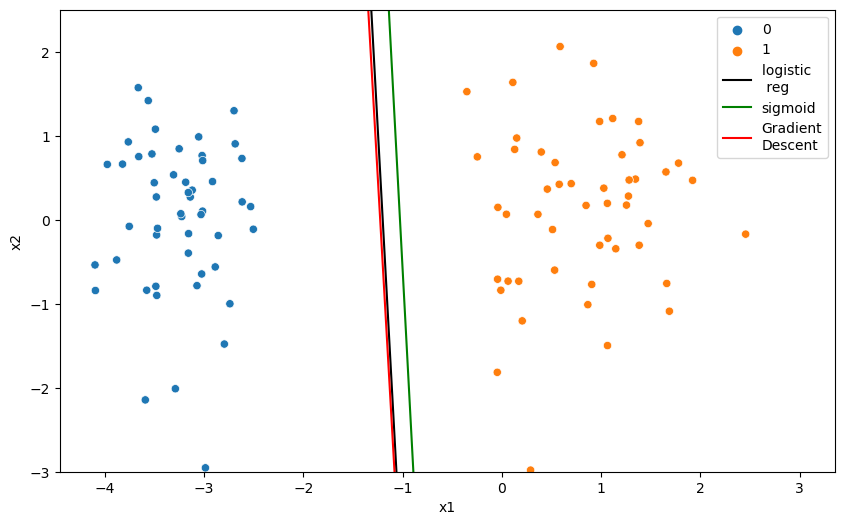

In [156]:
plt.figure(figsize = (10,6))
xi = np.linspace(-3,3,2)
sns.scatterplot(data=df2, x='x1', y='x2', hue = 'y')

sns.lineplot(x=xi, y=m_lor3*xi+c_lor3, color = 'black', label = 'logistic \n reg')
sns.lineplot(x=xi, y=slop*xi+intercep, color = 'green', label = 'sigmoid')
sns.lineplot(x=xi, y=m3*xi+c3, color = 'Red', label = 'Gradient\nDescent')
plt.ylim(-3,2.5)
plt.show()

In [191]:
x_2, y_2 = make_classification(n_samples=100, n_features=2, n_informative=2, n_redundant=0,
                          n_classes=3, n_clusters_per_class=1, random_state=41, hypercube=False, 
                          class_sep=10)

In [192]:
df3 = pd.DataFrame(data = {"x1":x_2[:,0], 'x2':x_2[:,1], 'y':y_2})

In [193]:
df3

,x1,x2,y
0,2.272269,-3.013530,0
1,1.224668,-4.704308,0
2,0.767934,0.234604,2
3,-0.827895,0.858446,1
4,0.614848,0.238314,2
...,...,...,...
95,-1.374866,2.032761,1
96,0.344784,0.267819,2
97,0.116424,0.546133,1
98,1.000171,0.502092,2


In [214]:
import math
math.log(0.7) + math.log(0.4)

-1.2729656758128876

In [216]:
math.log(0.7) + math.log(0.4) + math.log(0.8) + math.log(0.4)

-2.4123999590012524

<Axes: xlabel='x1', ylabel='x2'>

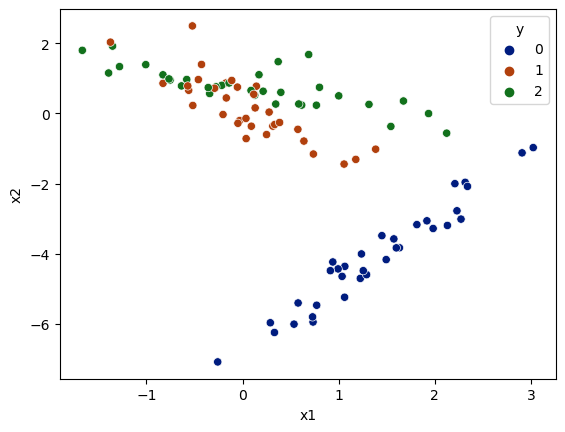

In [206]:
sns.scatterplot(data = df3, x='x1', y='x2', hue = 'y', palette='dark')

## Softmax and multinomial Logistic regression

In [16]:
df4 = sns.load_dataset('iris')
df4.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [17]:
encoder = LabelEncoder()
df4['species'] = encoder.fit_transform(df4['species'])

In [44]:
df4.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0


In [76]:
df4.describe()

,sepal_length,sepal_width,petal_length,petal_width,species
count,150.000000,150.000000,150.000000,150.000000,150.000000
mean,5.843333,3.057333,3.758000,1.199333,1.000000
std,0.828066,0.435866,1.765298,0.762238,0.819232
min,4.300000,2.000000,1.000000,0.100000,0.000000
25%,5.100000,2.800000,1.600000,0.300000,0.000000
50%,5.800000,3.000000,4.350000,1.300000,1.000000
75%,6.400000,3.300000,5.100000,1.800000,2.000000
max,7.900000,4.400000,6.900000,2.500000,2.000000


In [27]:
encoder.classes_

array(['setosa', 'versicolor', 'virginica'], dtype=object)

In [82]:
# using training data only for sepal and petal length
x4 = df4[['sepal_length', 'petal_length']]
y4 = df4.iloc[:,-1]

In [83]:
lor3 = LogisticRegression(multi_class='multinomial', max_iter=150)

In [84]:
x4_tr, x4_ts, y4_tr, y4_ts = train_test_split(x4, y4, test_size=0.2, random_state=1)

In [85]:
lor3.fit(x4_tr, y4_tr)

LogisticRegression(max_iter=150, multi_class='multinomial')

In [86]:
y4_pred = lor3.predict(x4_ts)

In [87]:
accuracy_score(y_pred=y4_pred, y_true=y4_ts)

0.9666666666666667

In [88]:
pd.DataFrame(confusion_matrix(y4_ts, y4_pred))

,0,1,2
0,11,0,0
1,0,12,1
2,0,0,6


In [89]:
query = np.array([[5.8, 4.35]])
lor3.predict_proba(query)

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


array([[0.00937798, 0.79089925, 0.19972277]])

In [90]:
lor3.predict(query)

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


array([1])

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


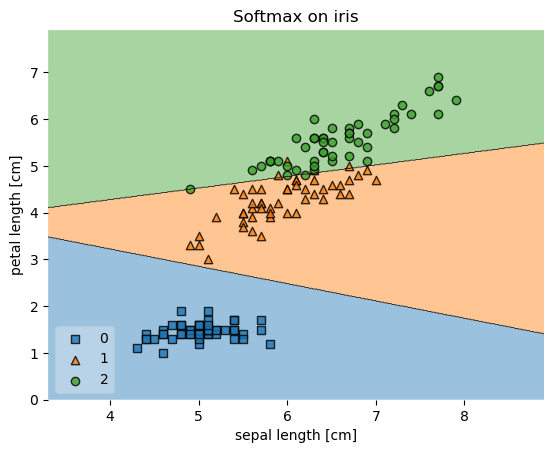

In [296]:
plot_decision_regions(x4.values, y4.values, lor3, legend = 3)
plt.xlabel('sepal length [cm]')
plt.ylabel('petal length [cm]')
plt.title('Softmax on iris')
plt.show()

In [312]:
lor3.coef_, lor3.intercept_

(array([[-0.30542842, -2.87991462],
        [ 0.6086351 , -0.40853913],
        [-0.30320668,  3.28845375]]),
 array([ 11.80132273,   0.18407713, -11.98539986]))

In [329]:
lor3.classes_

array([0, 1, 2])

In [324]:
ms = -pd.DataFrame(lor3.coef_)[0]/pd.DataFrame(lor3.coef_)[1]
cs = -pd.DataFrame(lor3.intercept_)[0]/pd.DataFrame(lor3.coef_)[1]
ms, cs

(0   -0.106055
 1    1.489784
 2    0.092203
 dtype: float64,
 0    4.097803
 1    0.450574
 2    3.644692
 dtype: float64)

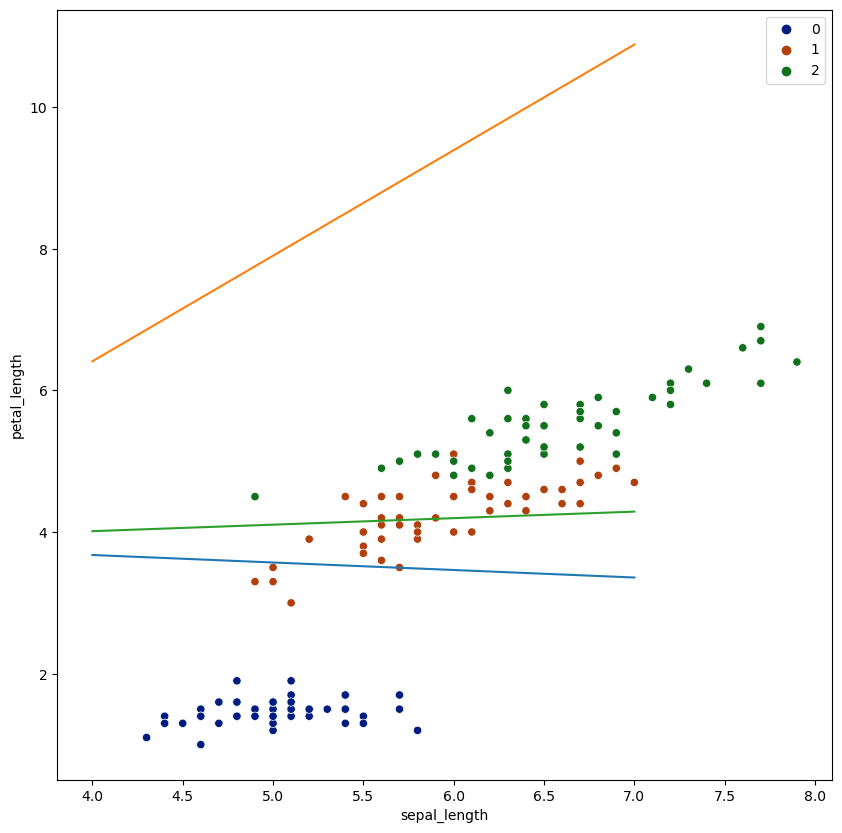

In [333]:
plt.figure(figsize = (10,10))
sns.scatterplot(data=df4, x = 'sepal_length', y = 'petal_length', hue = 'species', palette='dark')
temp = np.arange(4,8,1)
sns.lineplot(x = temp, y = -0.106*temp+4.1)
sns.lineplot(x = temp, y = 1.49*temp+0.45)
sns.lineplot(x = temp, y = 0.092*temp+3.644)
plt.show()

In [121]:
def Logistic_with_GD(x, y, epoch = 1000, lr = 0.1):
    import numpy as np
    def sigmoid(x):
        return 1/(1+np.exp(-x))    
    x = np.insert(x, 0, 1, axis = 1)
    weights = np.ones(x.shape[1])
    for i in range(epoch):
        y_hat = sigmoid(np.dot(x, weights))
        weights = weights + (lr * np.dot((y - y_hat), x) / x.shape[0])
    return weights[1:], weights[0]

In [503]:
np.dot(np.array([[2,3],[4,2]]), np.array(2))

array([[4, 6],
       [8, 4]])

In [439]:
def softmax(x1):
    x1 = np.longdouble(x1)
    y1 = []; dr = np.longdouble(0)
    for i in range(len(x1)):
        dr = expit(x1[i]) + dr
    for i in range(len(x1)):
        y1.append(np.round((expit(x1[i])/dr), 4))
    return y1

In [511]:
def softmax_modified(x, y, lr = 0.1, epochs = 1000):        
    import numpy as np
    from scipy.special import expit
    def softmax(x1):
        x1 = np.longdouble(x1)
        y1 = []; dr = np.longdouble(0)
        for i in range(len(x1)):
            dr = expit(x1[i]) + dr
        for i in range(len(x1)):
            y1.append(np.round((expit(x1[i])/dr), 4))
        return y1
    x = np.insert(x, 0, 1, axis = 1)
    weights = np.ones((x.shape[1], y.shape[1]))
    for i in range(epochs):
        point_coor = np.dot(x, weights)
        y_hat = np.array([softmax(i) for i in point_coor])
        weights = weights + (lr * np.dot((np.array(y) - y_hat).T,x) / x.shape[0])
    return weights

In [472]:
in1= df5.iloc[:,:2]; out1 = np.array(df5.iloc[:,3:])
in1 = np.insert(in1, in1.shape[1], 1, axis = 1)
weights = np.ones((in1.shape[1], out1.shape[1]))

In [506]:
for i in range(1000):
    temp = np.round(np.dot(in1, weights),4);
    temp2 = np.array([softmax(i) for i in temp])
    weights = weights + (0.5 * np.dot(in1.T, (np.array(out1) - temp2)) / in1.shape[0])

In [507]:
temp2

array([[1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [3.900e-03, 0.000e+00, 9.961e-01],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [2.238e-01, 0.000e+00, 7.762e-01],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e-04, 0.000e+00, 9.999e-01],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 0.000e+00, 0.000e+00],
       [3.908e-01, 0.000e+00, 6.09

In [502]:
res = pd.DataFrame(weights);res

,0,1,2
0,-82.711123,-176.702947,-102.980401
1,267.287011,383.095221,194.991234
2,-336.975414,-26.485829,-110.351268


In [515]:
res = pd.DataFrame(softmax_modified(df5.iloc[:,:2], df5.iloc[:,3:], epochs=1000, lr = 0.1)); res

,0,1,2
0,1.006681,-26.875522,-75.516129
1,0.999813,4.090938,17.740786
2,0.999583,25.823168,60.807140


In [516]:
ms = -res[1]/res[2]
cs = -res[0]/res[2]; cs, ms

(0    0.013331
 1   -0.056357
 2   -0.016439
 dtype: float64,
 0   -0.355891
 1   -0.230595
 2   -0.424673
 dtype: float64)

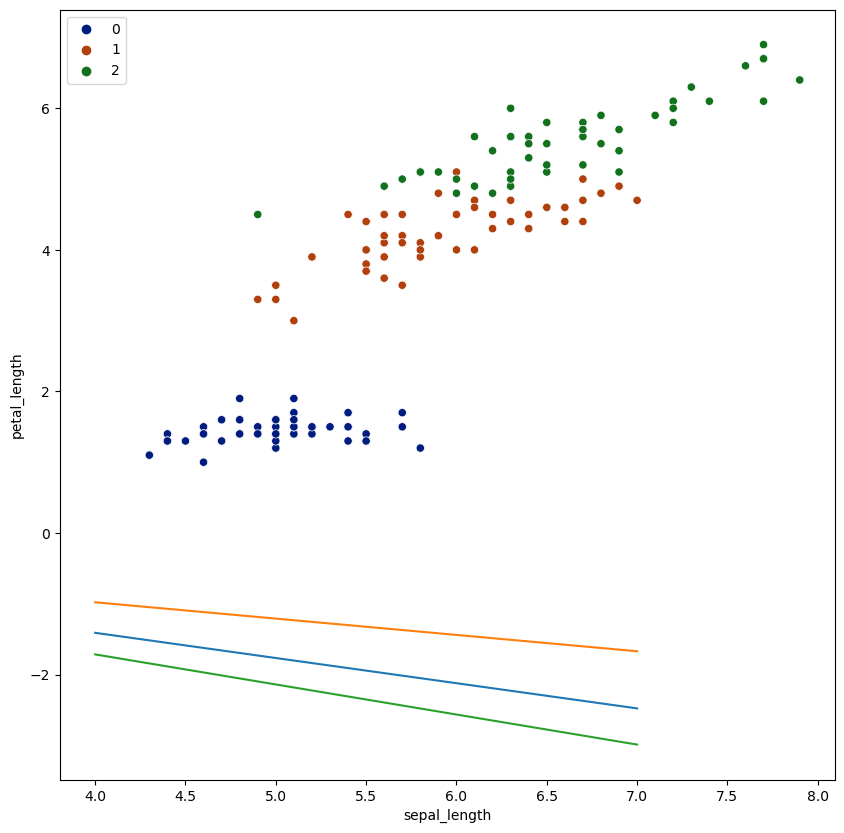

In [517]:
plt.figure(figsize = (10,10))
sns.scatterplot(data=df4, x = 'sepal_length', y = 'petal_length', hue = 'species', palette='dark')
temp = np.arange(4,8,1)
sns.lineplot(x = temp, y = ms[0]*temp+cs[0])
sns.lineplot(x = temp, y = ms[1]*temp+cs[1])
sns.lineplot(x = temp, y = ms[2]*temp+cs[2])
plt.show()

In [181]:
df5 = sns.load_dataset('iris')
df5.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [188]:
np.ones((2,3))

array([[1., 1., 1.],
       [1., 1., 1.]])

In [182]:
df5 = pd.concat([df5, pd.get_dummies(df5, columns=['species'], dtype='int', 
                               prefix = "", prefix_sep="").iloc[:,-3:]], axis = 1)

In [184]:
df5.drop(columns={'sepal_width', 'petal_width'}, inplace=True)

In [186]:
df5.head()

,sepal_length,petal_length,species,setosa,versicolor,virginica
0,5.1,1.4,setosa,1,0,0
1,4.9,1.4,setosa,1,0,0
2,4.7,1.3,setosa,1,0,0
3,4.6,1.5,setosa,1,0,0
4,5.0,1.4,setosa,1,0,0


### Polynomial Logistic regression

In [24]:
df6 = pd.read_csv('ushape.csv', header=None)

In [25]:
df6[['x1', 'x2', 'y']] = df6
df6 = df6.iloc[:, 3:]

In [66]:
df6['y'] = df6['y'].astype('int64')
df6.head()

,x1,x2,y
0,0.031595,0.986988,0
1,2.115098,-0.046244,1
2,0.882490,-0.075756,0
3,-0.055144,-0.037332,1
4,0.829545,-0.539321,1


<Axes: xlabel='x1', ylabel='x2'>

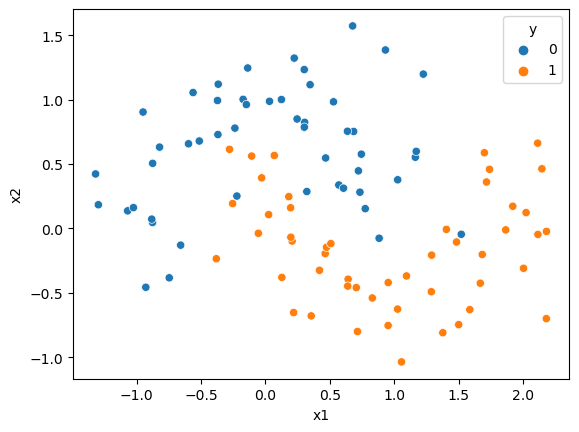

In [67]:
sns.scatterplot(data = df6, x = 'x1', y = 'x2', hue = 'y')

In [68]:
lor4 = LogisticRegression()

In [69]:
lor4.fit(df6.iloc[:, :2], df6.iloc[:, 2])

LogisticRegression()

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but LogisticRegression was fitted with feature names
  warnings.warn(


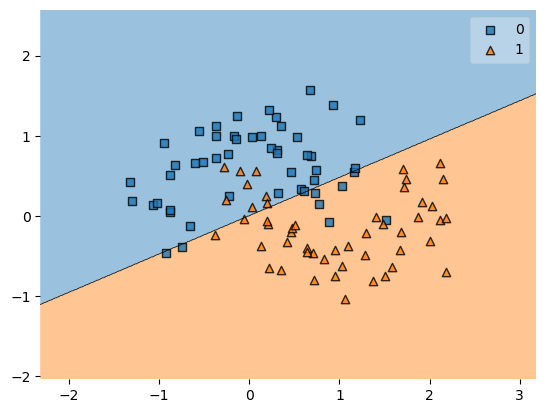

In [73]:
plot_decision_regions(df6.iloc[:, :2].values, df6.iloc[:, 2].values, lor4)
plt.show()

Many misclassifications

In [75]:
np.mean(cross_val_score(lor4, df6.iloc[:, :2], df6.iloc[:, 2], scoring='accuracy', cv=10))

0.8300000000000001

In [90]:
# using PolynomialFeatures
poly = PolynomialFeatures(degree=3, include_bias=False)
x_transform = poly.fit_transform(df6.iloc[:, :2]); x_transform

array([[ 3.15949936e-02,  9.86987758e-01,  9.98243623e-04,
         3.11838719e-02,  9.74144834e-01,  3.15395009e-05,
         9.85254235e-04,  3.07780998e-02,  9.61469026e-01],
       [ 2.11509784e+00, -4.62439679e-02,  4.47363887e+00,
        -9.78105167e-02,  2.13850457e-03,  9.46218392e+00,
        -2.06878813e-01,  4.52314640e-03, -9.88929368e-05],
       [ 8.82489720e-01, -7.57560552e-02,  7.78788106e-01,
        -6.68539399e-02,  5.73897989e-03,  6.87272498e-01,
        -5.89979147e-02,  5.06459076e-03, -4.34762477e-04],
       [-5.51441040e-02, -3.73324592e-02,  3.04087220e-03,
         2.05866501e-03,  1.39371251e-03, -1.67686173e-04,
        -1.13523237e-04, -7.68550276e-05, -5.20307155e-05],
       [ 8.29545028e-01, -5.39321493e-01,  6.88144954e-01,
        -4.47391463e-01,  2.90867673e-01,  5.70847225e-01,
        -3.71131364e-01,  2.41287832e-01, -1.56871188e-01],
       [ 2.11285708e+00,  6.62083533e-01,  4.46416503e+00,
         1.39888788e+00,  4.38354605e-01,  9.432142

In [91]:
poly.powers_

array([[1, 0],
       [0, 1],
       [2, 0],
       [1, 1],
       [0, 2],
       [3, 0],
       [2, 1],
       [1, 2],
       [0, 3]], dtype=int64)

In [86]:
# now applying this transformed input to the model
lor5 = LogisticRegression()
np.mean(cross_val_score(lor5, x_transform, df6.iloc[:, 2], scoring='accuracy', cv=10))

0.9

In [204]:
def plot_decision_boundaries(x, y, degree=1):
    plt.style.use("classic")
    
    poly = PolynomialFeatures(degree = degree)
    x_transform = poly.fit_transform(x)
    lor6 = LogisticRegression()
    lor6.fit(x_transform, y)
    accuracy_scr = np.round(np.mean(cross_val_score(lor6, x_transform, y, scoring = 'accuracy', cv = 10)), 2)

    a = np.arange(start = x.iloc[:,0].min()-1, stop = x.iloc[:,0].max()+1, step = 0.01)
    b  = np.arange(start = x.iloc[:,1].min()-1, stop = x.iloc[:,1].max()+1, step = 0.01)
    xx, yy = np.meshgrid(a,b)
    input_arr = np.array([xx.ravel(), yy.ravel()]).T
    labels = lor6.predict(poly.transform(input_arr))
    plt.contour(xx, yy, labels.reshape(xx.shape), alpha = 0.5, lw = 2)
    plt.scatter(x.iloc[:, 0], x.iloc[:, 1], c = y, s=30)
    plt.title(f'Degree = {degree} & accuracy = {accuracy_scr}')
    plt.show()

In [158]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but PolynomialFeatures was fitted with feature names
  warnings.warn(
A:\Temp\ipykernel_9872\2242125248.py:15: UserWarning: The following kwargs were not used by contour: 'lw'
  plt.contour(xx, yy, labels.reshape(xx.shape), alpha = 0.5, lw = 2)


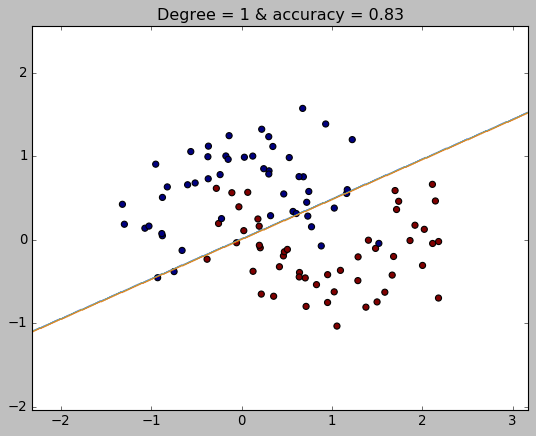

In [205]:
plot_decision_boundaries(df6.iloc[:, :2], df6.iloc[:, 2])

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but PolynomialFeatures was fitted with feature names
  warnings.warn(


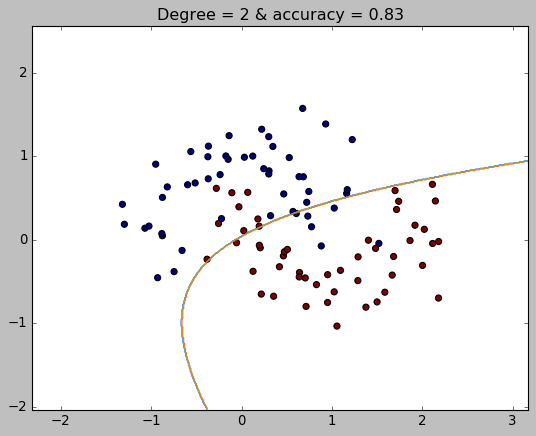

In [199]:
plot_decision_boundaries(df6.iloc[:, :2], df6.iloc[:, 2], degree = 2)

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but PolynomialFeatures was fitted with feature names
  warnings.warn(


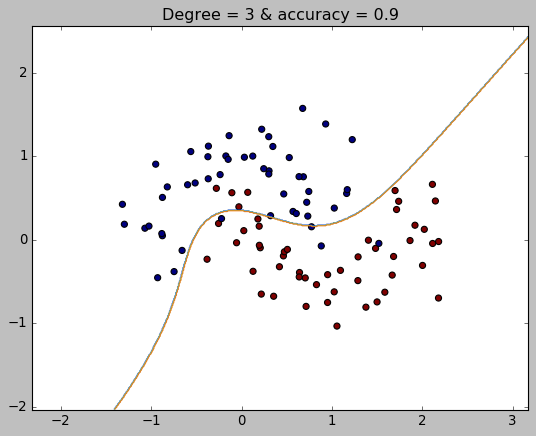

In [200]:
plot_decision_boundaries(df6.iloc[:, :2], df6.iloc[:, 2], degree = 3)

This is good.

C:\ProgramData\miniforge3\lib\site-packages\sklearn\base.py:465: UserWarning: X does not have valid feature names, but PolynomialFeatures was fitted with feature names
  warnings.warn(


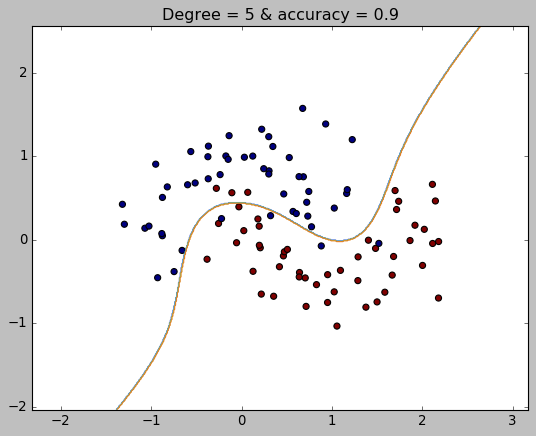

In [201]:
plot_decision_boundaries(df6.iloc[:, :2], df6.iloc[:, 2], degree = 5)

Better